# Todo


* Build PCA from much larger set of sky observations
* work off real spectra (not sky_spectrum)



# Notes
* here we go all the way to have many skys to compute the PCA from and then applying it to a small selection of actually interesting observations lateron
* all experiments are currently in pca_sky1.ipynb and pca_sky3.ipynb 
* this notebook is meant for production

In [51]:
# go wide screen
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# Next two lines force automatic reload of loaded module. Convenient if
# one is still fiddeling with them.
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [52]:
import numpy as np

from astropy.io import fits
from astropy.stats import biweight_location
from sklearn.decomposition import PCA
import pickle
import os
import glob
from matplotlib import pyplot as plt
% matplotlib inline

from collections import OrderedDict
import spectrum

In [53]:
def load_skys(ff, which="sky_spectrum", normalize=False):
    """
    Loads bunch of spectra (2D) from set of input file names.
    """
    skys = OrderedDict()
    shotids = OrderedDict()
    N = len(ff)
    sff = []
    for i,f in enumerate(ff):
        if i % 100 == 0:
            print("loading {} out of {}.".format(i,N))
        shotid = f.split("/")[2]
        exp = f.split("/")[3]
        try:
            ww,rb = pickle.load( open(f,'rb'), encoding='iso-8859-1' )
            skys[(shotid,exp)] = rb[which]/rb["fiber_to_fiber"] 
            shotids[(shotid,exp)] = f
        except:
            print("Error loading {}.".format(f))
            pass
        
        if normalize:
            # NEW try to normalize by mean
            skys[(shotid,exp)][np.isnan(skys[(shotid,exp)])] = 0.
            skys[(shotid,exp)] = (skys[(shotid,exp)].T /np.mean( skys[(shotid,exp)], axis=1 )).T
    print("start wl = ", ww[0], "A", "end wl = ", ww[-1], "A")
    return ww, skys, sff

In [54]:
def build_XA(IFU, ww, skys, wstart, wend):
    # Select referece source
    # here we will use as A  the beiweight location (~ mean) from the entire IFU 
    XA = []
    for k in skys[(IFU,"LU")]:
        amps = []
        if k in skys[(IFU,"LU")]:
            amps.append( skys[(IFU,"LU")][k] )
        if k in skys[(IFU,"LL")]:
            amps.append( skys[(IFU,"LL")][k] )
        if k in skys[(IFU,"RU")]:
            amps.append( skys[(IFU,"RU")][k] )
        if k in skys[(IFU,"RL")]:
            amps.append( skys[(IFU,"RL")][k] )
        stack = np.vstack(amps)
        bloc = biweight_location( stack, axis=0) 
        XA.append(bloc)

    XA = np.array(XA)

    # hack to homogenize lengths, the rebinning does make sure
    # that the wavelength grid always stars at the same wavelength
    # but not necessarey, end at the same ( ther may be a few pixel more or less)
    #N = np.min([XA.shape[1], XB.shape[2], ww.shape[0]])
    N = np.min([XA.shape[1], ww.shape[0]])
    ww = ww[:N]
    XA = XA[:,:N]

    # can't have nans
    XA[np.isnan(XA)] = 0.

    ii = (ww >= wstart) * (ww <= wend)
    wwcut = ww[ii]
    XAcut = XA[:,ii]

    return wwcut, XAcut

In [55]:
def build_XB(IFU, amp, ww, skys, wstart, wend):
    B = (IFU, amp) # here we select, which IFU and amp we build the 
                     # PCA sky for
        
    # first build big array that holds all skys in B
    XB = np.array( [skys[B][k] for k in skys[B] ] )

    #N = XA.shape[1]
    ii = (ww >= wstart) * (ww <= wend)
    
    ## we homogenize the length
    #XB = XB[:,:,:N]
    # set nans to zero
    XB[np.isnan(XB)] = 0.
    # and select a spectral subrange as set above
    XBcut = XB[:,:,ii]

    return wwcut, XBcut


In [56]:
IFU="022"
dir_rebin="pca_test/rebin"
# selct wavelength subrange
wstart = 3495.
#wend = 5493.
wend = 5454.76 # masking out one bad feature at the red end

MEANSHIFT = True

# how many PCA components do we want to maintain?
n_components = 20
USEPCA = True

amps = ["LL", "LU", "RL", "RU"]


In [57]:
fn_shotlist_pca = "shotlist_pca.txt"
fn_shotlist_skyrecon = "shotlist_skyrecon.txt"

with open(fn_shotlist_pca, 'r') as f:
    s = f.read()
shotlist_PCA = s.split()

with open(fn_shotlist_skyrecon, 'r') as f:
    s = f.read()
shotlist_skyrecon = s.split()



# First part: Compute PCA components for A and pseudo-components for B based on a large number of skys

In [58]:
# load rebinned data

def load_skys_for_shotlist(IFU, shotlist, amps):
    # load all skys for given list of shots
    # this newer version makes sure that there is always date for all four amplifieres
    ff = OrderedDict()
    for amp in amps:
        ff[amp] = []
    exposures = ['exp01','exp02','exp03']
    for shot in shotlist:
        if shot.startswith("#"):
            continue
        for e in exposures:
            pattern = "{}/{}/{}/multi_???_{}_???_{}_rebin.pickle".format(dir_rebin, shot, e,IFU, "??")
            fff = np.sort(glob.glob(pattern))
            if len( fff ) == 4:
                ff['LL'] += [fff[0]]
                ff['LU'] += [fff[1]]
                ff['RL'] += [fff[2]]
                ff['RU'] += [fff[3]]
            else:
                print("WARNING: for {} exp {}, not all four amps have data, dropping ....".format(shot, e))
    skys = OrderedDict()
    for amp in amps:
        ww,skys[(IFU,amp)],sff = load_skys(ff[amp],which="sky_spectrum")

    return ww,skys


ww, skys = load_skys_for_shotlist(IFU, shotlist_PCA, amps)

shotids = [k for k in skys[(IFU,"LL")] ]

# build data matrix A
wwcut, _XAcut = build_XA(IFU, ww, skys, wstart, wend)


loading 0 out of 366.


/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in true_divide
  app.launch_new_instance()
/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()


loading 100 out of 366.
loading 200 out of 366.
loading 300 out of 366.
start wl =  3494.74 A end wl =  5498.4523582 A
loading 0 out of 366.
loading 100 out of 366.
loading 200 out of 366.
loading 300 out of 366.
start wl =  3494.74 A end wl =  5496.4665184 A
loading 0 out of 366.
loading 100 out of 366.
loading 200 out of 366.
loading 300 out of 366.
start wl =  3494.74 A end wl =  5492.494838799999 A
loading 0 out of 366.
loading 100 out of 366.
loading 200 out of 366.
loading 300 out of 366.
start wl =  3494.74 A end wl =  5498.4523582 A


/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 4 results
  r = func(a, **kwargs)
/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/astropy/stats/biweight.py:112: RuntimeWarning: invalid value encountered in greater_equal
  mask = (np.abs(u) >= 1)
/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 5 results
  r = func(a, **kwargs)
/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 26 results
  r = func(a, **kwargs)
/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 25 results
  r = func(a, **kwargs)
/Users/mxhf/.pyenv/versions/an

303 of 366 survive cut.


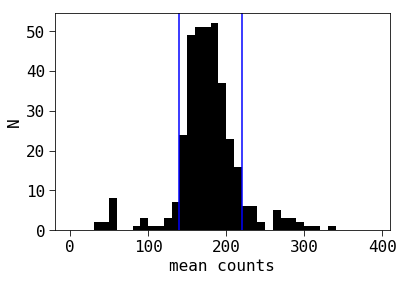

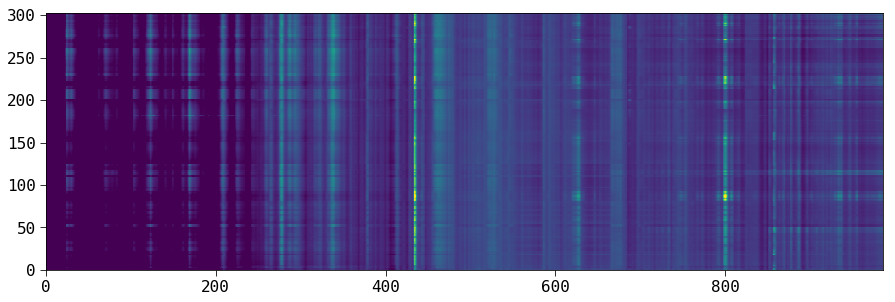

In [59]:
mm = np.mean( _XAcut[:,450:600], axis=1)

start, stop = 140., 220.
jj = (mm > start) * (mm < stop)
print("{} of {} survive cut.".format(np.sum(jj),len(jj)))

if True:
    plt.hist(mm,bins=np.arange(0,400,10))
    plt.axvline(start,c='b')
    plt.axvline(stop,c='b')
    plt.xlabel("mean counts")
    plt.ylabel("N")

    #% matplotlib notebook
    f = plt.figure(figsize=[15,15])
    #plt.imshow((XAcut.T/mm).T[jj*kk][:,275:300], vmin=.6,vmax=1.4, origin="bottom")
    plt.imshow((_XAcut.T/mm).T[jj], vmin=.6,vmax=2.4, origin="bottom")

XAcut = _XAcut[jj]



# normilze (usually done by scikit.learn's PCA method also, but useful for plotting etc.)
MA = np.mean(XAcut,axis=0)
if MEANSHIFT:
    XAmean = XAcut - MA
else:
    XAmean = XAcut

In [60]:
XAcut.shape

(303, 986)

In [61]:
if False:
    # some simple test to see what sky features correlate
    
    img =(_XAcut.T/mm).T[jj]

    #% matplotlib notebook
    f = plt.figure(figsize=[15,15])
    #plt.imshow(img[:,432:436], vmin=.6,vmax=2.4, origin="bottom")


    #plt.imshow(img[:,797:803], vmin=.6,vmax=2.4, origin="bottom")
    #plt.imshow(img[:,455:472], vmin=.6,vmax=2.4, origin="bottom")




    f = plt.figure(figsize=[5,5])
    plt.plot( np.sum(img[:,432:436], axis=1), np.sum(img[:,797:803], axis=1),'.')

    _ll = np.argsort( np.sum(img[:,432:436], axis=1) ) 
    #_ll = np.argsort( np.sum(img[:,455:472], axis=1) ) 

    f = plt.figure(figsize=[15,15])
    plt.imshow(img[_ll,:], vmin=.6,vmax=2.4, origin="bottom")


In [62]:
# Add synthetic lines in every B - spectrum
# random wavelength
# random sigma (3.5 - 10. A)
# random amplitude (20 - 100. A)
if False:
    #generic gaussian
    def gauss(mu, sigma, x):
        return 1./(sigma * np.sqrt(2. * np.pi) ) * np.exp( -(x-mu)**2./(2. * sigma**2.))

    gg = []
    
    for i in range(XBcut.shape[0]):
        mu = np.random.uniform()* (wwcut[-1] - wwcut[0]) + wwcut[0]
        sigma = np.random.uniform() * 10. + 3.5
        A = np.random.uniform() * 90. + 20.

        g = A*gauss(mu, sigma, wwcut)

        XBcut[i]  = XBcut[i] + g
        
        gg.append(g)

[9798.67835094 5322.8268998  2196.45250654 1286.97283482  613.53536168
  539.54169672  484.87067876  301.47719979  296.2167917   255.49297089
  224.62442459  186.27670399  166.44551768  119.59958542  112.24642
   91.86387192   87.85319773   76.40956617   68.51961796   60.09774807]


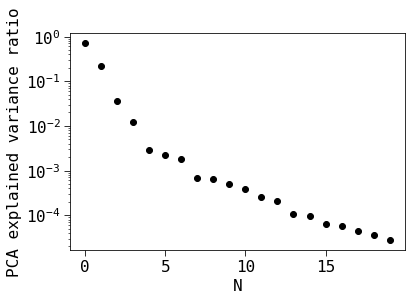

In [63]:
# PCA computation for A

if USEPCA:
    if not MEANSHIFT:
        print("ERROR: PCA must use mean shift") 
    else:
        pcaA = PCA(n_components=n_components)
        pcaA.fit(XAmean)
        plt.plot(pcaA.explained_variance_ratio_, 'o')  
        plt.xlabel("N")
        plt.ylabel("PCA explained variance ratio")
        plt.yscale('log')
        print(pcaA.singular_values_) 
else:
    # SVD computation for A
    from sklearn.decomposition import TruncatedSVD
    pcaA = TruncatedSVD(n_components=n_components, n_iter=7, random_state=42)
    pcaA.fit(XAmean)
    plt.plot(pcaA.explained_variance_ratio_, 'o')  
    plt.xlabel("N")
    plt.ylabel("SVD explained variance ratio")
    plt.yscale('log')
    print(pcaA.singular_values_) 

In [64]:
# project pca componets onto
#  mean shifted input spectra
ccA = np.inner(XAmean, pcaA.components_)

# reconstruct pca comonents through linear combination
rcA = np.matmul( XAmean.T, ccA).T

# they won't be normalized yet
for i,cA in enumerate(rcA):
    rcA[i] = rcA[i]/np.linalg.norm(rcA[i])

In [65]:
# make sure the result is the same
if not (np.abs( rcA - pcaA.components_) < 1e-6).all():
    print("ERROR: Recontructed PCA components are not (almost) identical to the original ones.")
else:
    print("Reconstructed PCAs look good.")

ERROR: Recontructed PCA components are not (almost) identical to the original ones.


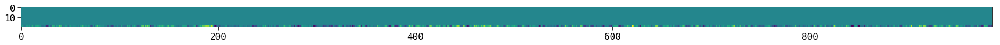

In [66]:
f=plt.figure(figsize=[30,5])
plt.imshow( rcA - pcaA.components_ )

In [67]:
np.log( np.abs(np.matmul(rcA, rcA.T )) ).max()

4.440892098500625e-16

/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


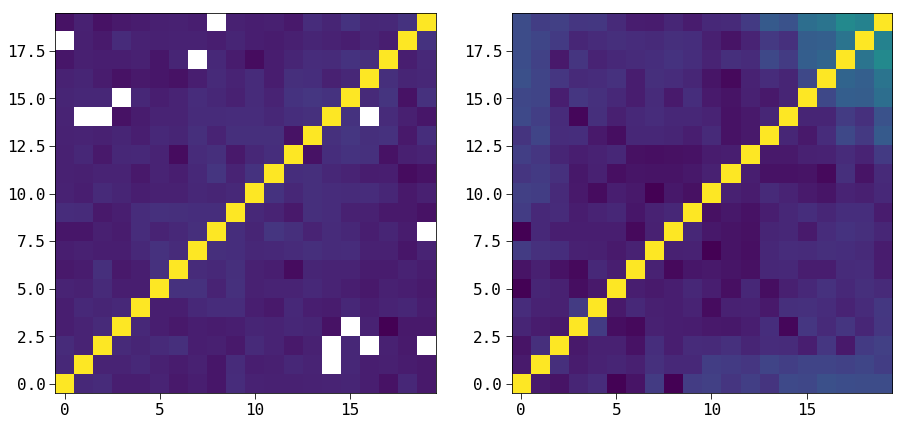

In [68]:
f = plt.figure(figsize=[15,7])
plt.subplot(121)
plt.imshow(  np.log( np.abs(np.matmul(pcaA.components_, pcaA.components_.T ))), origin='bottom')

plt.subplot(122)
plt.imshow( np.log( np.abs(np.matmul(rcA, rcA.T )) ), origin='bottom', vmin=-38, vmax=0.)

In [69]:
# save pca components of A
pca_comp_fname = "{}/pca_comp_A_{}.pickle".format(dir_rebin, IFU)
#pickle.dump(  (MA, pcaA.components_) , open(pca_comp_fname,'wb') , protocol=2   )
pickle.dump(  (MA, rcA) , open(pca_comp_fname,'wb') , protocol=2   )
print("Wrote {}".format(pca_comp_fname))

Wrote pca_test/rebin/pca_comp_A_022.pickle


Wrote pca_test/rebin/pca_comp_B_022_LL.pickle
Wrote pca_test/rebin/pca_comp_B_022_LU.pickle
Wrote pca_test/rebin/pca_comp_B_022_RL.pickle
Wrote pca_test/rebin/pca_comp_B_022_RU.pickle


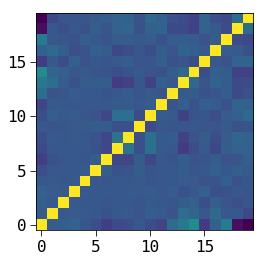

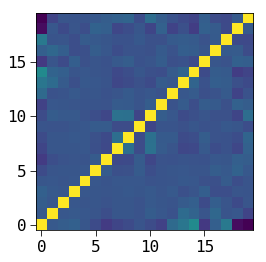

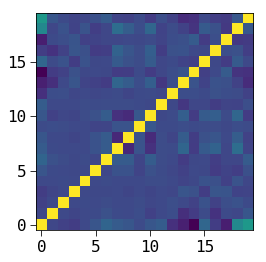

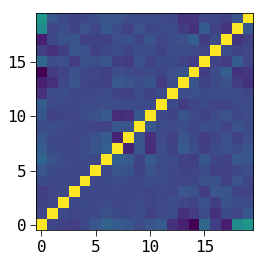

In [70]:
for amp in amps:
    wwcut, XBcut = build_XB(IFU, amp, ww, skys, wstart, wend)
    # now we subtract the mean of each column!, this is probably unnecassary as
    # the scikit learn PCA already does this, but it helps the plotting and so forth
    MB = np.mean(XBcut[jj],axis=0)
    if MEANSHIFT:
        XBmean = XBcut[jj] - MB
    else:
        XBmean = XBcut[jj]
    ### reconstruct pca components of all B fibers through linear combination of spectra from B ###
    rcB = OrderedDict() # will hald for all fibers (in the current amp) all the pseudo PCA components
    for fiber in range(XBmean.shape[1]):
        # BUT using projection from A
        rcB[fiber] = np.matmul( XBmean[:,fiber,:].T, ccA).T
        # they wont be normalized yet
        for j,cB in enumerate(rcB[fiber]):
            rcB[fiber][j] = rcB[fiber][j]/np.linalg.norm(rcB[fiber][j])
            
    pca_comp_fname = "{}/pca_comp_B_{}_{}.pickle".format(dir_rebin,IFU,amp)
    pickle.dump(  (MB,rcB) , open(pca_comp_fname,'wb') , protocol=2   )
    print("Wrote {}".format(pca_comp_fname))
    
    
    f = plt.figure()
    plt.imshow( np.arcsinh( np.matmul(rcB[75], rcB[75].T ) ), origin='bottom')

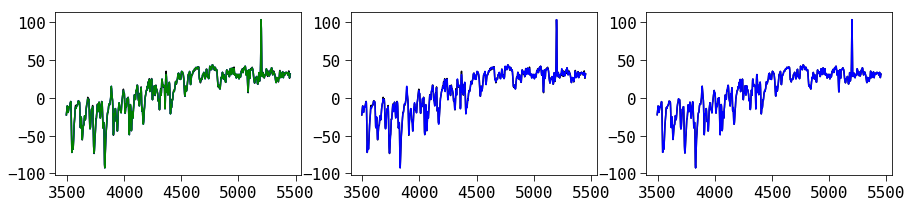

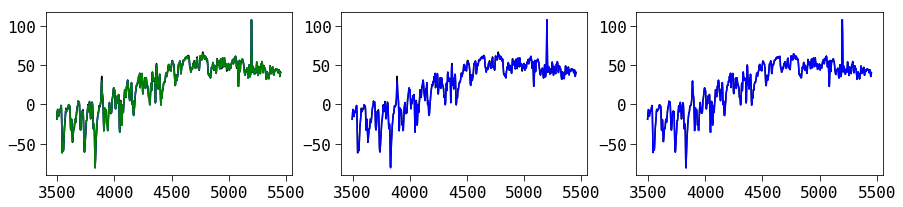

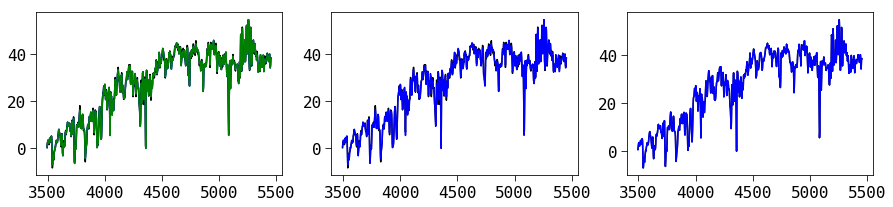

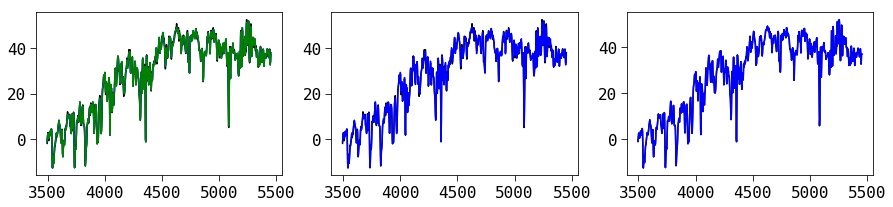

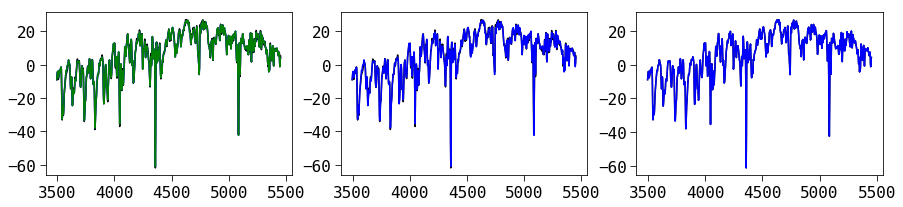

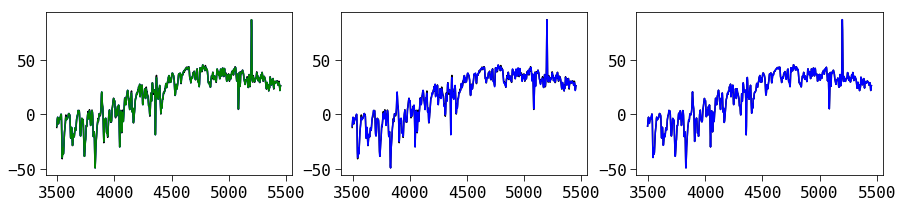

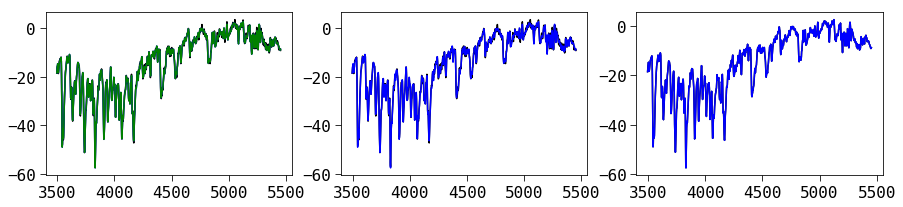

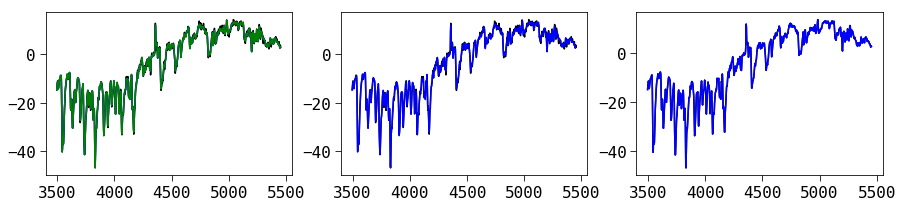

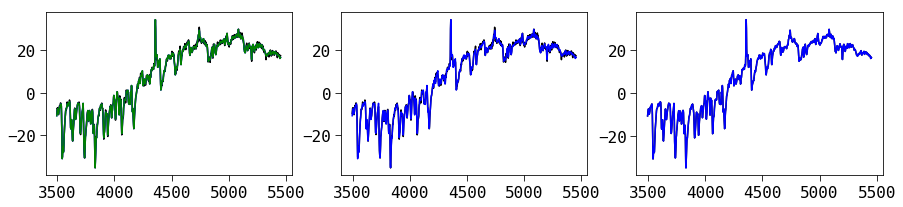

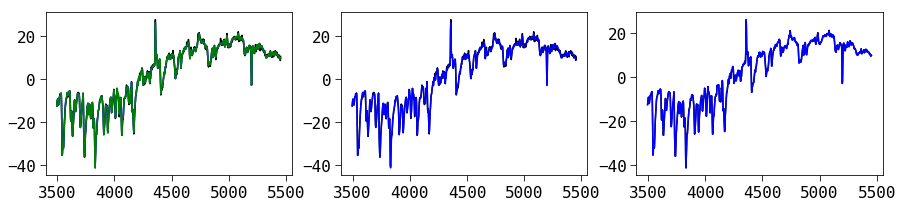

In [71]:
if True:
    # compute projection of input spectra onto PCA basis
    #tA = pcaA.transform(XAmean)
    tA = np.matmul( XAmean, rcA.T)


    # make sure we can reconstuct the spectra from the
    # actual principal components but also from the reconstructed ones
    for i in range(10):
        f = plt.figure(figsize=[15,3])
        plt.subplot(131)
        plt.plot(wwcut, XAmean[i] )
        plt.plot(wwcut,  np.inner(tA, pcaA.components_.T)[i] )
        plt.plot(wwcut,  pcaA.inverse_transform(tA)[i] )


        plt.subplot(132)
        plt.plot(wwcut,  XAmean[i] )
        plt.plot(wwcut,  np.inner(tA, rcA.T)[i] )


        plt.subplot(133)
        plt.plot(wwcut,  np.inner(tA, pcaA.components_.T)[i] )
        plt.plot(wwcut,  np.inner(tA, rcA.T)[i] )


# Now apply this to B

In [72]:
# load pca components of A
pca_comp_fname = "pca_test/rebin/pca_comp_A_{}.pickle".format(IFU)
MA,rcA = pickle.load( open(pca_comp_fname,'rb'), encoding='iso-8859-1' )

ww, skys = load_skys_for_shotlist(IFU, shotlist_skyrecon, amps)  
    
shotids = [k for k in skys[(IFU,"LL")] ]

# build data matrix A
wwcut, XAcut = build_XA(IFU, ww, skys, wstart, wend)

# normalize 
# but normalize with respect to 
# the mean that we used fot the PCA component calculation
#MA = np.mean(XAcut,axis=0)
if MEANSHIFT:
    XAmean = XAcut - MA
else:
    XAmean = XAcut
# compute projection of input spectra onto PCA basis
ccA2 = np.inner(XAmean, rcA)

loading 0 out of 24.
start wl =  3494.74 A end wl =  5498.4523582 A
loading 0 out of 24.
start wl =  3494.74 A end wl =  5496.4665184 A
loading 0 out of 24.


/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in true_divide
  app.launch_new_instance()
/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()


start wl =  3494.74 A end wl =  5492.494838799999 A
loading 0 out of 24.
start wl =  3494.74 A end wl =  5498.4523582 A


/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 5 results
  r = func(a, **kwargs)
/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/astropy/stats/biweight.py:112: RuntimeWarning: invalid value encountered in greater_equal
  mask = (np.abs(u) >= 1)
/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 4 results
  r = func(a, **kwargs)


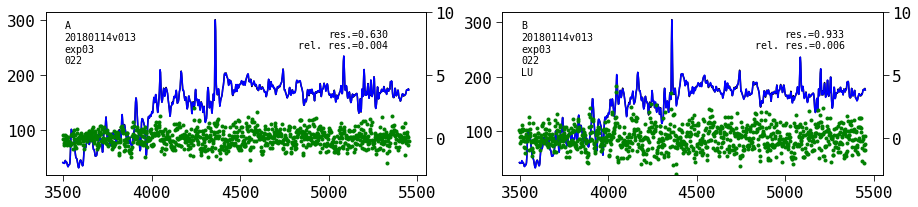

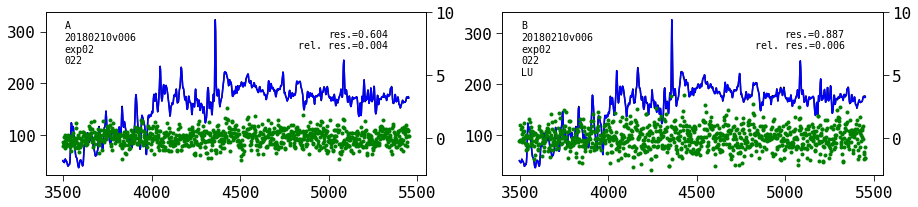

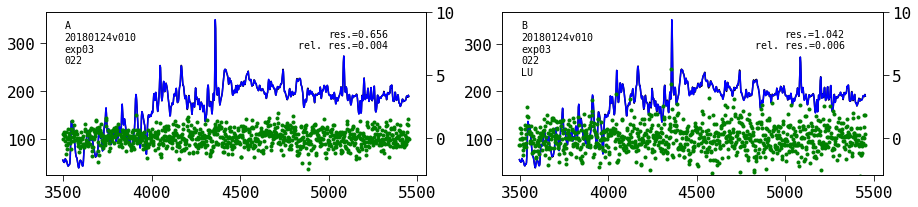

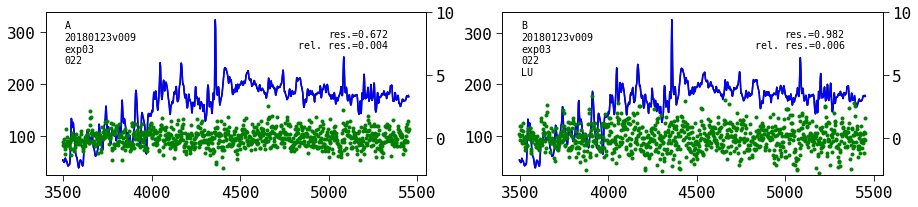

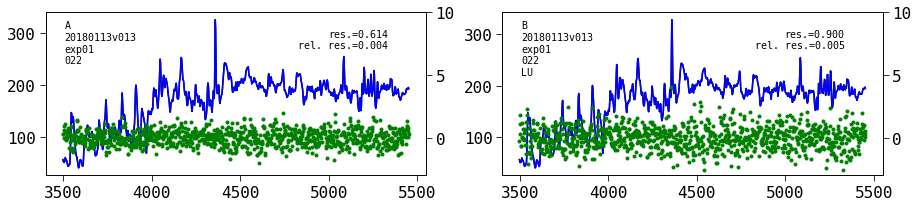

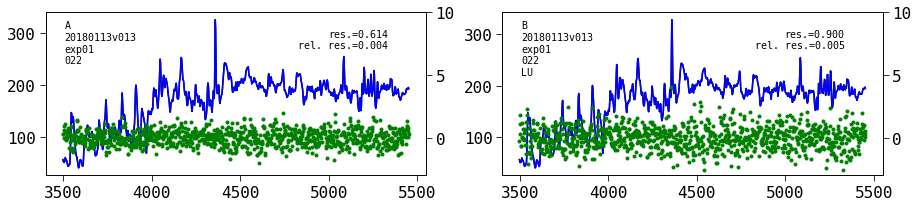

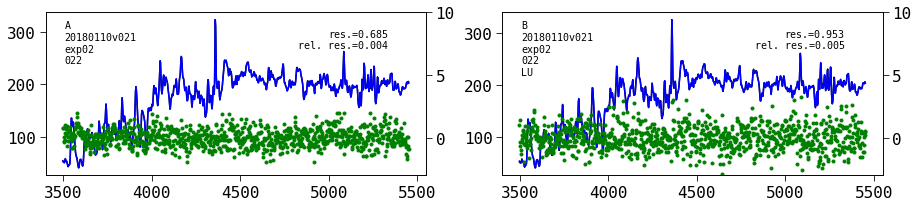

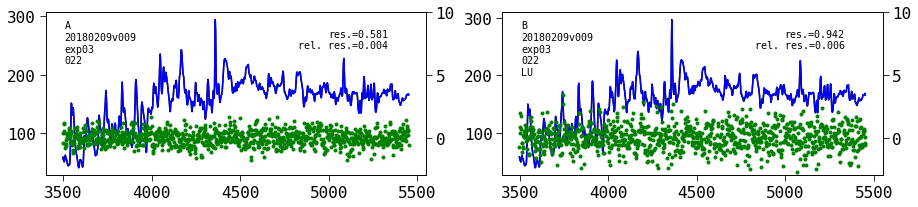

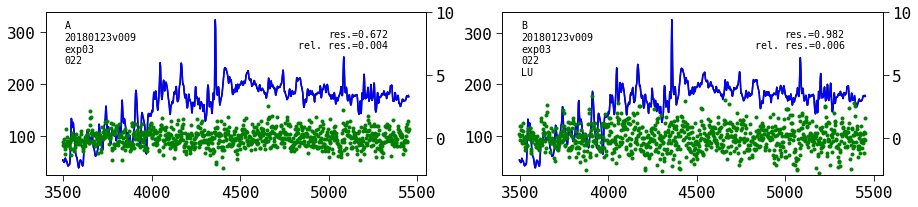

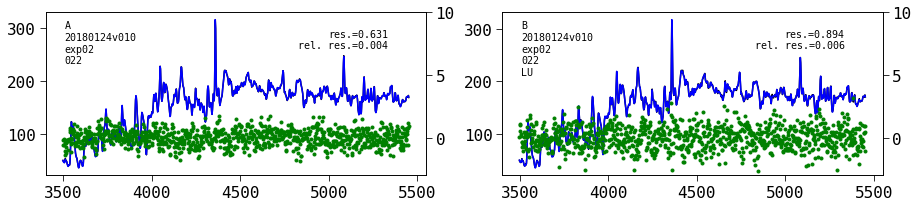

Wrote  pca_test/rebin/20180110v021/exp01/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180110v021/exp02/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180110v021/exp03/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp01/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp02/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp03/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp01/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp02/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp03/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp01/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp02/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp03/pca_multi_317_022_039_LU_rebin.pickle
Wrote  pca_test/rebin/20180123v009/exp01/pca_multi_3

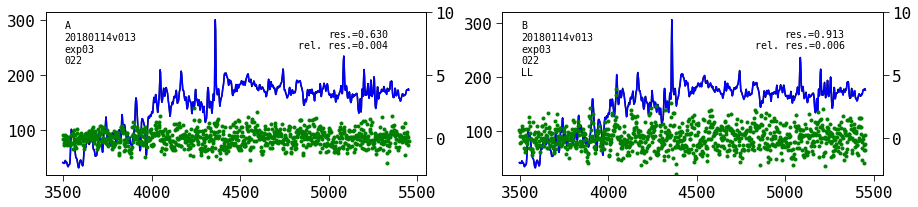

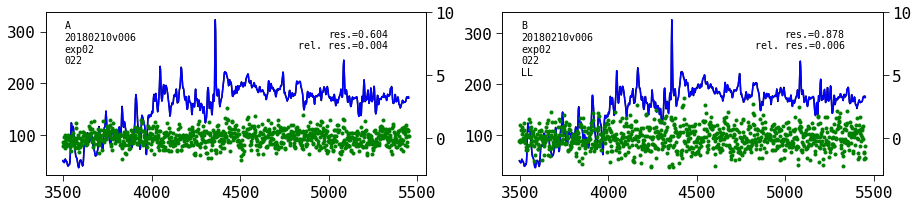

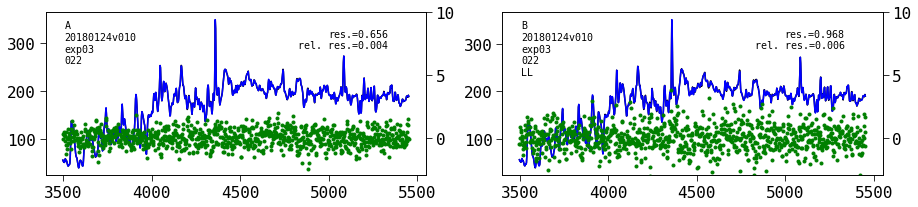

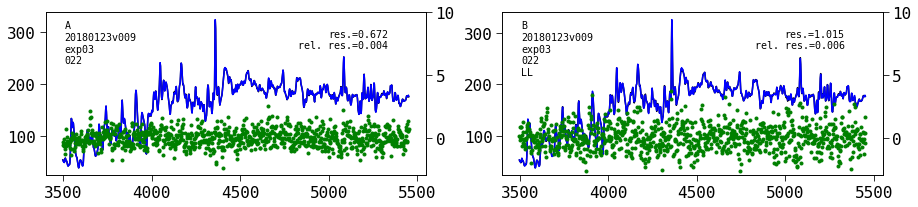

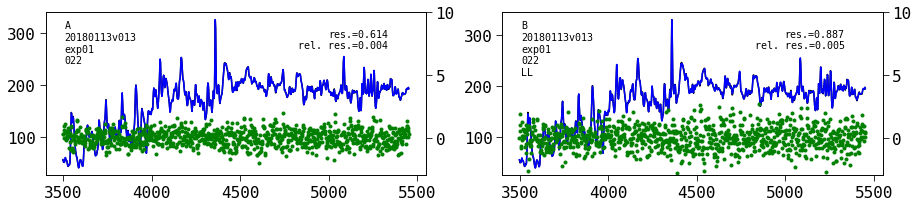

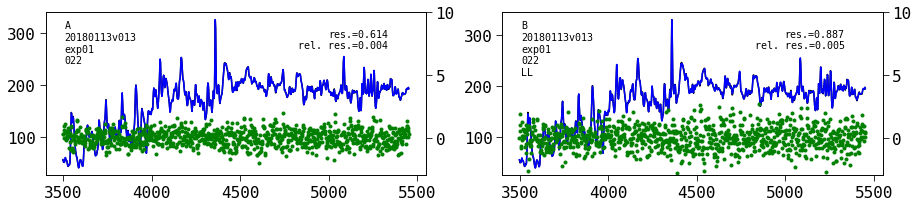

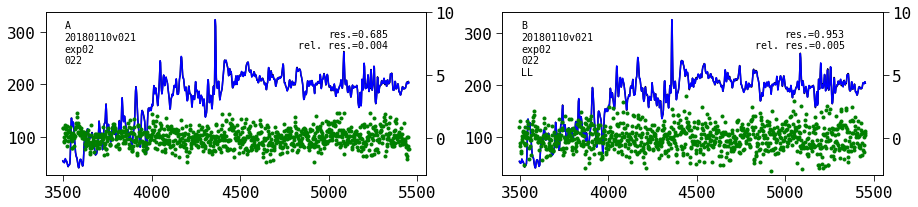

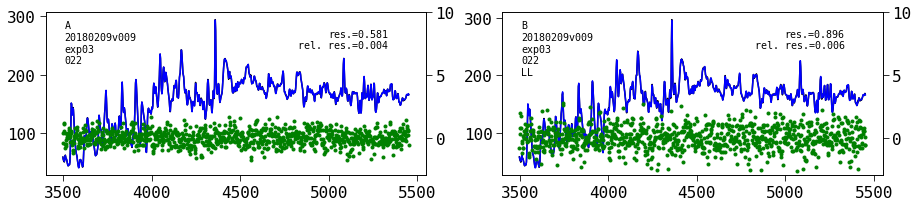

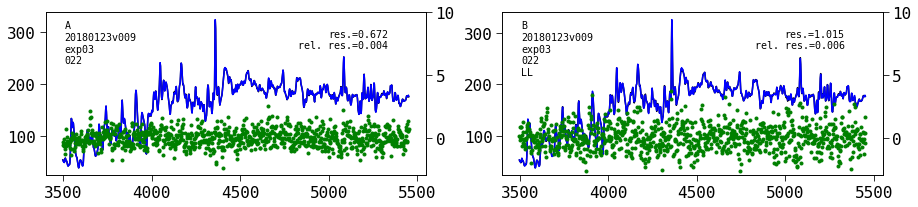

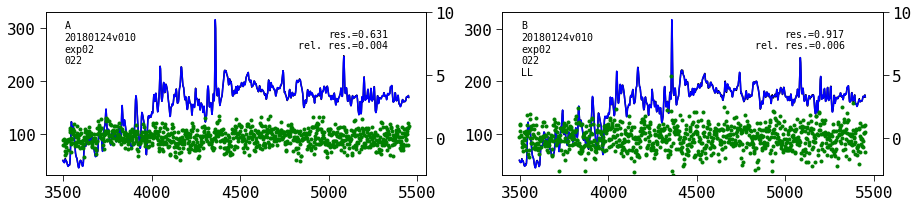

Wrote  pca_test/rebin/20180110v021/exp01/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180110v021/exp02/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180110v021/exp03/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp01/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp02/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp03/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp01/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp02/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp03/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp01/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp02/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp03/pca_multi_317_022_039_LL_rebin.pickle
Wrote  pca_test/rebin/20180123v009/exp01/pca_multi_3

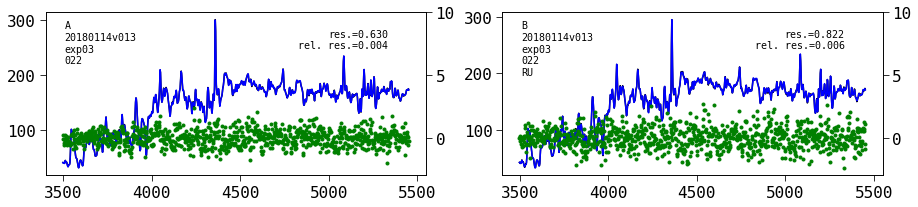

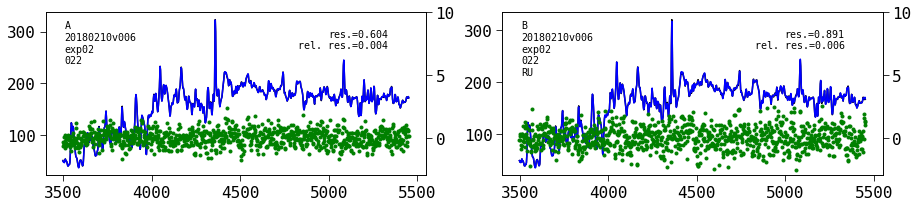

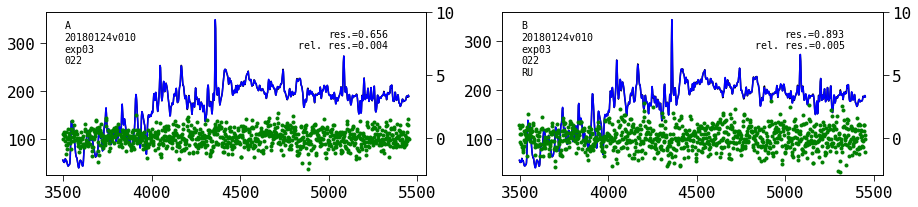

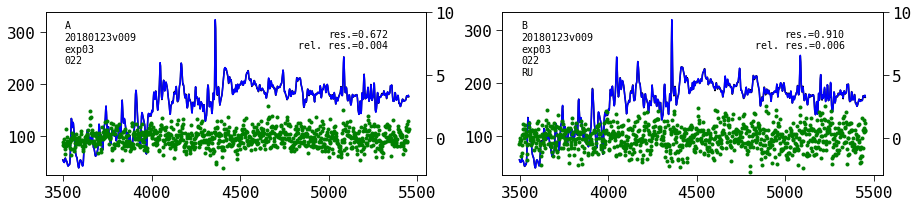

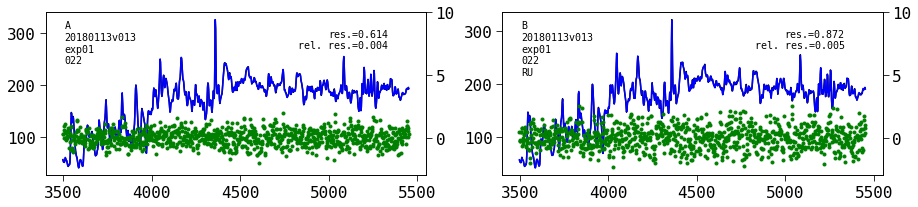

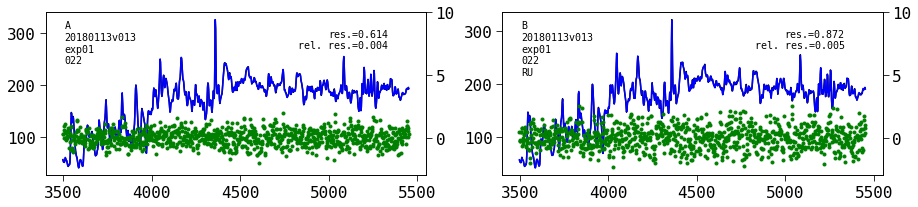

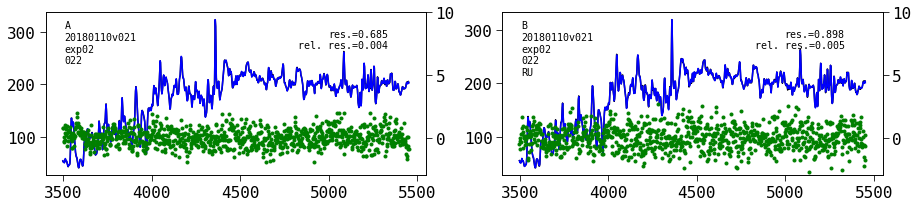

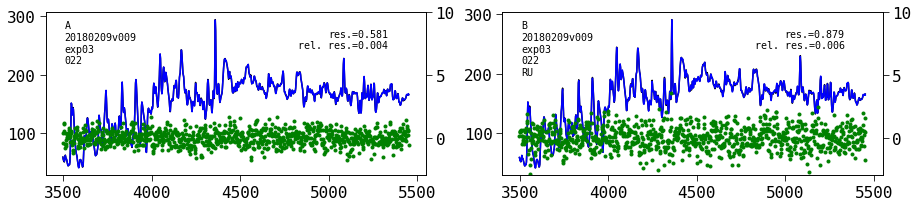

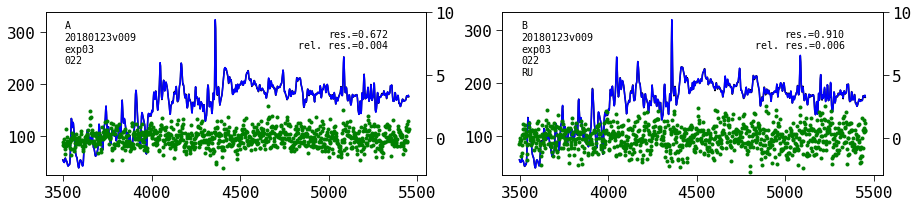

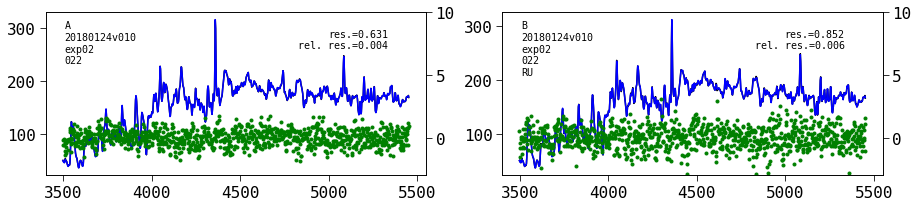

Wrote  pca_test/rebin/20180110v021/exp01/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180110v021/exp02/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180110v021/exp03/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp01/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp02/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp03/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp01/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp02/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp03/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp01/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp02/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp03/pca_multi_317_022_039_RU_rebin.pickle
Wrote  pca_test/rebin/20180123v009/exp01/pca_multi_3

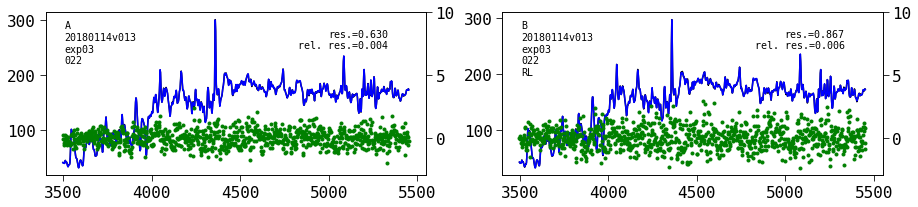

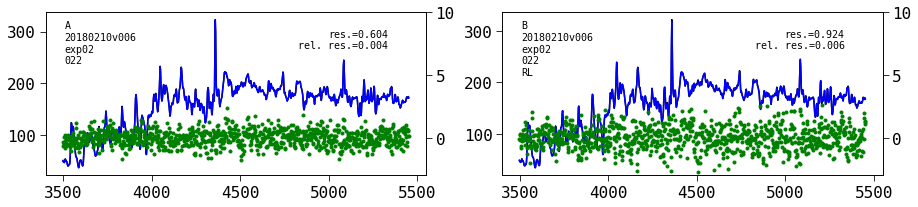

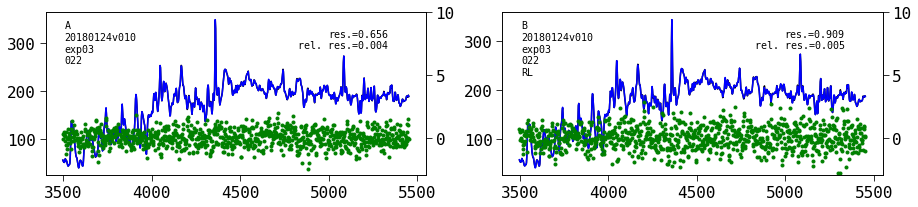

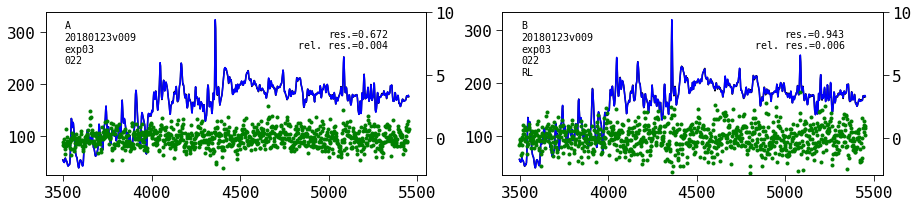

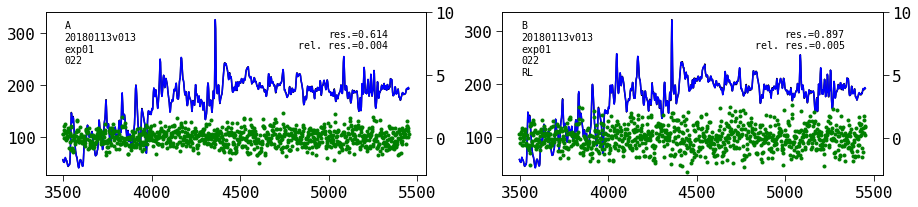

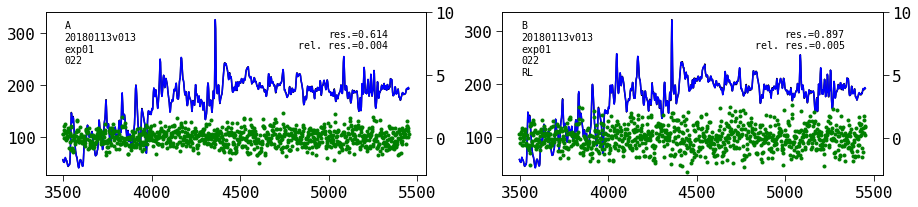

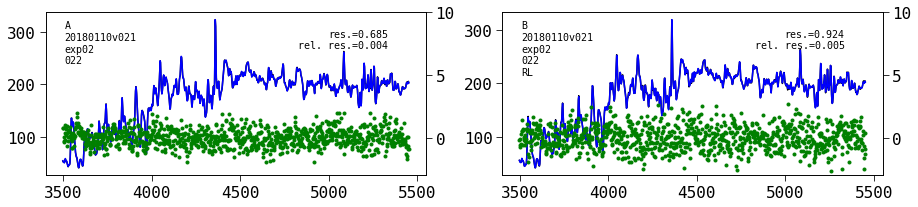

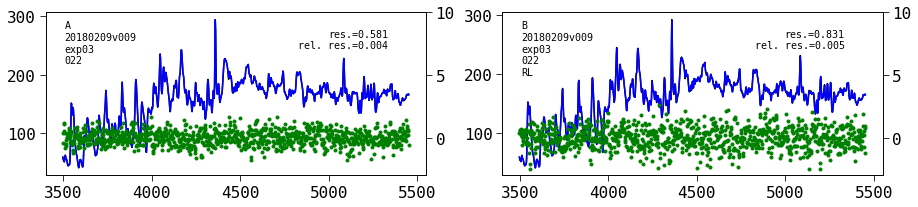

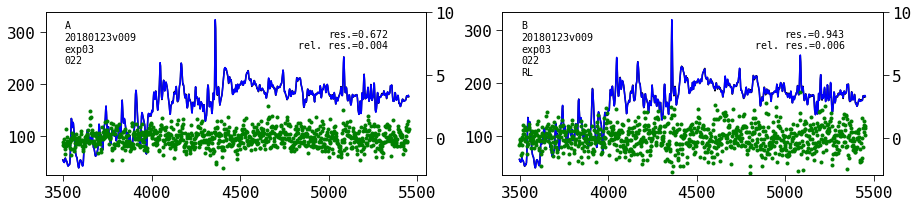

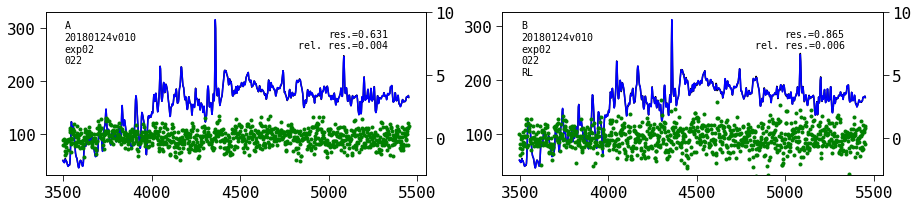

Wrote  pca_test/rebin/20180110v021/exp01/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180110v021/exp02/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180110v021/exp03/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp01/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp02/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180113v013/exp03/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp01/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp02/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180114v013/exp03/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp01/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp02/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180120v008/exp03/pca_multi_317_022_039_RL_rebin.pickle
Wrote  pca_test/rebin/20180123v009/exp01/pca_multi_3

In [74]:
from numpy import polyfit, polyval
    
for amp in ["LU", "LL", "RU", "RL"]:
#for amp in ["LL"]:
    B = (IFU, amp) 

    # load pca components of B
    pca_comp_fname = "pca_test/rebin/pca_comp_B_{}_{}.pickle".format(IFU,amp)
    MB, rcB = pickle.load( open(pca_comp_fname,'rb'), encoding='iso-8859-1' )

    wwcut, XBcut = build_XB(IFU, amp, ww, skys, wstart, wend)
    # now we subtract the mean of each column!, this is probably unnecassary as
    # the scikit learn PCA already does this, but it helps the plotting and so forth
    #MB = np.mean(XBcut,axis=0)
    if MEANSHIFT:
        XBmean = XBcut - MB
    else:
        XBmean = XBcut

    ### reconstruct pca components of all B fibers through linear combination of spectra from B ###
    #rcB = OrderedDict() # will hald for all fibers (in the current amp) all the pseudo PCA components
    #for fiber in range(XBmean.shape[1]):
    #    # BUT using projection from A
    #    rcB[fiber] = np.matmul( XBmean[:,fiber,:].T, ccA2).T
    #    # they wont be normalized yet
    #    for j,cB in enumerate(rcB[fiber]):
    #        rcB[fiber][j] = rcB[fiber][j]/np.linalg.norm(rcB[fiber][j])
                
    # Now reconstruct sky for all exposures and fibers
    B_recon_sky = np.zeros_like(XBmean)
    for i in range(XBmean.shape[0]): # loop over exposures
        for fiber in range(XBmean.shape[1]):  # loop over fibers
            # now compute sky from pseudo PCA components of B
            # according to weights of A
            B_recon_sky[i,fiber,:] = np.inner(ccA2, rcB[fiber].T)[i] + MB[fiber,:]
            

    
    
            y  = XBmean[i,fiber,:] + MB[fiber,:] # original sky in B
            ry = B_recon_sky[i,fiber,:]          # reconstructed sky in B
            res = ry-y

            p = polyfit(wwcut, res, deg=5)
            B_recon_sky[i,fiber,:] -= polyval(p, wwcut)
    
    # Quality control
    # plot for 10 randomly picked exposures
    # recontrcuted sky and residuals of one (or a few) fiber(s)
    np.random.seed(42)
    qa_exposures = np.array( np.random.uniform(size=10) * XBmean.shape[0], dtype=int)
    qa_fibers = [75]
    
    from IPython.display import display
    
    for i in qa_exposures: # loop over exposures
        for fiber in qa_fibers:  # loop over fibers
            
            f = plt.figure(figsize=[15,3])
            ax = plt.subplot(121)
            
            y  = XAmean[i] + MA
            ry = np.inner(ccA2, rcA.T)[i] + MA
            res = ry-y
            plt.plot(wwcut,  y )
            plt.plot(wwcut,   ry )
            plt.twinx()
            plt.plot(wwcut,   res, 'g.'  )
            plt.ylim([-3.,10.])
            plt.text(0.9,0.9,"res.={:.3f}\n rel. res.={:.3f}".format(np.std(res), np.std(res)/np.abs(np.mean(y)) ), transform = ax.transAxes, ha='right',va='top')
            plt.text(0.05,0.95,"A\n{}\n{}\n{}".format(shotids[i][0], shotids[i][1], B[0],  fiber ), transform = ax.transAxes, ha='left',va='top')
            
            ax = plt.subplot(122, sharex=ax)
            y  = XBmean[i,fiber,:] + MB[fiber,:] # original sky in B
            ry = B_recon_sky[i,fiber,:]          # reconstructed sky in B
            res = ry-y

            plt.plot(wwcut,   y )
            plt.plot(wwcut,   ry )
            plt.twinx()

            plt.plot(wwcut,   res, 'g.' )
            plt.ylim([-3.,10.])
            plt.text(0.9,0.9,"res.={:.3f}\n rel. res.={:.3f}".format(np.std(res), np.std(res)/np.abs(np.mean(y)) ), transform = ax.transAxes, ha='right',va='top')
            plt.text(0.05,0.95,"B\n{}\n{}\n{}\n{}".format(shotids[i][0], shotids[i][1], B[0],  B[1], fiber ), transform = ax.transAxes, ha='left',va='top')
                     
            display(f)
            plt.close()

    def save_sky(IFU, amp , k, wwcut, pca_sky):
        
       
        
        pattern="pca_test/rebin/{}/{}/multi_???_{}_???_{}_rebin.pickle"
        shotid, exp = k

        _pattern = pattern.format(shotid, exp, IFU, amp)
        ff = glob.glob(_pattern)
        if not len(ff) == 1:
            print("ERROR: Did not find files like {}".format(_pattern))
            return
        fname = ff[0]

        h,t = os.path.split(fname)
        pca_fname = os.path.join(h,"pca_" + t)

        ww,rb = pickle.load( open(fname,'rb'), encoding='iso-8859-1' )
        
        N = np.min([ww.shape[0], rb['sky_subtracted'].shape[1], rb["fiber_to_fiber"].shape[1], rb["sky_spectrum"].shape[1]])
        rb["fiber_to_fiber"] = rb["fiber_to_fiber"][:,:N]
        rb["sky_subtracted"] = rb["sky_subtracted"][:,:N]
        ww = ww[:N]
        rb["sky_spectrum"] = rb["sky_spectrum"][:,:N]
        rb["pca_sky_spectrum"] = rb["sky_spectrum"].copy()
        ii = (ww >= wwcut[0]) * (ww <= wwcut[-1])
        rb["pca_sky_spectrum"][:,ii] = pca_sky * rb["fiber_to_fiber"][:,ii]
        
        
        rb['sky_subtracted'] = rb['sky_subtracted'] + rb['sky_spectrum'] - rb['pca_sky_spectrum']

        pickle.dump(  ( ww,rb), open(pca_fname,'wb') , protocol=2   )
        print("Wrote ", pca_fname)
        

        
    for i,k in enumerate(shotids):

        save_sky(IFU, amp , k, wwcut, B_recon_sky[i])



    #save_skys(B, pca_sky, pattern)

pca_test/rebin/20180113v013/exp01/pca_multi_317_022_039_LU_rebin.pickle


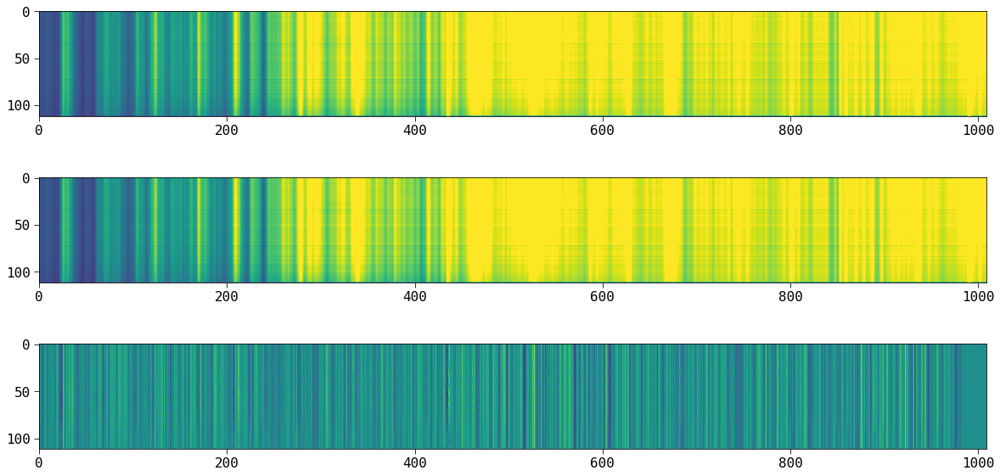

In [75]:
fn = "pca_test/rebin/20180113v013/exp01/pca_multi_317_022_039_LU_rebin.pickle"
ff = glob.glob(fn.format(IFU))
fn = ff[0]
print(fn)
ww,rb = pickle.load(open(fn, 'rb'))


f = plt.figure(figsize=[20,10])
#f = plt.figure()
plt.subplot(311)
plt.imshow( rb['sky_spectrum'] , vmax=200.)
plt.subplot(312)
plt.imshow( rb['pca_sky_spectrum'] , vmax=200.)
plt.subplot(313)
plt.imshow( rb['sky_spectrum'] - rb['pca_sky_spectrum'], vmin=-5., vmax=5. )

pca_test/rebin/20180110v021/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180110v021/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180110v021/exp03/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180113v013/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180113v013/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180113v013/exp03/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180114v013/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180114v013/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180114v013/exp03/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180120v008/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180120v008/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180120v008/exp03/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180123v009/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180123v009/exp02/pca_multi_???_022_???_LU_rebin

/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


pca_test/rebin/20180210v006/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180210v006/exp03/pca_multi_???_022_???_LU_rebin.pickle


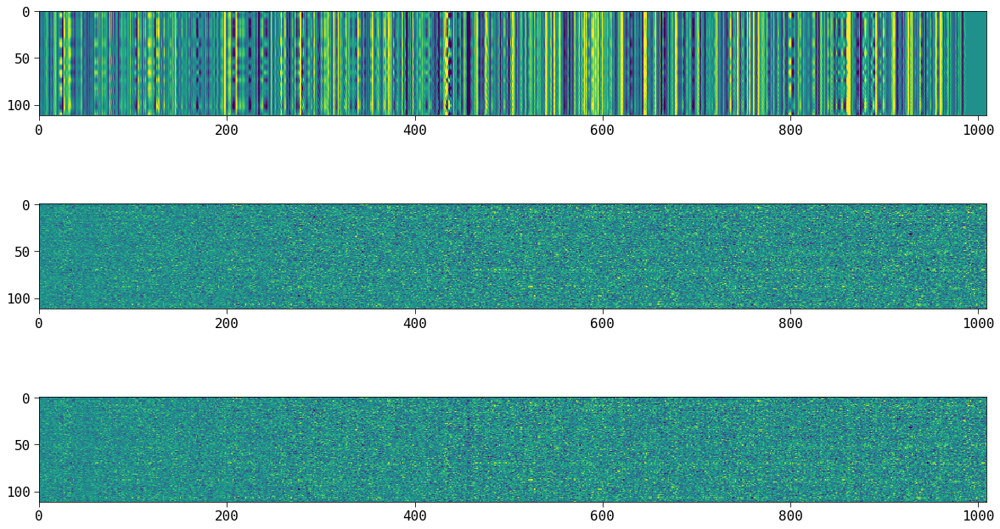

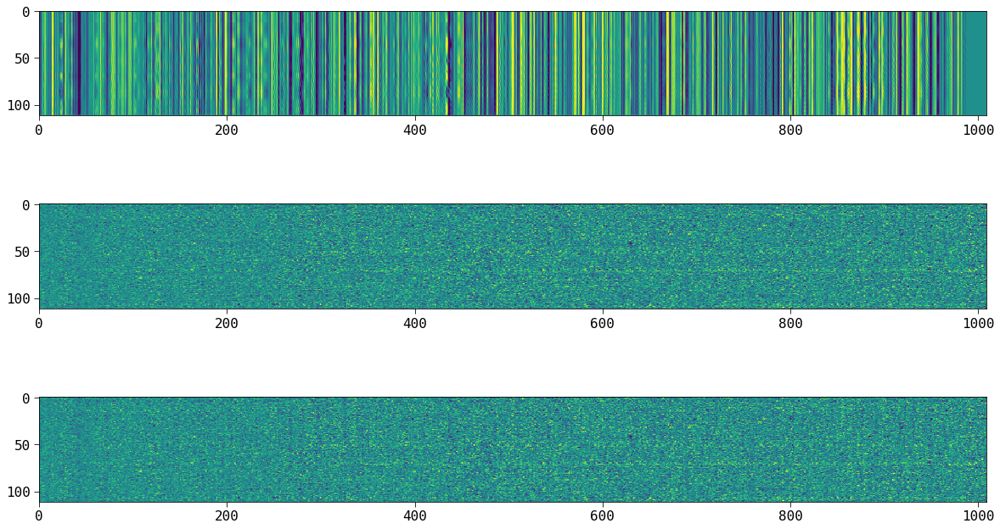

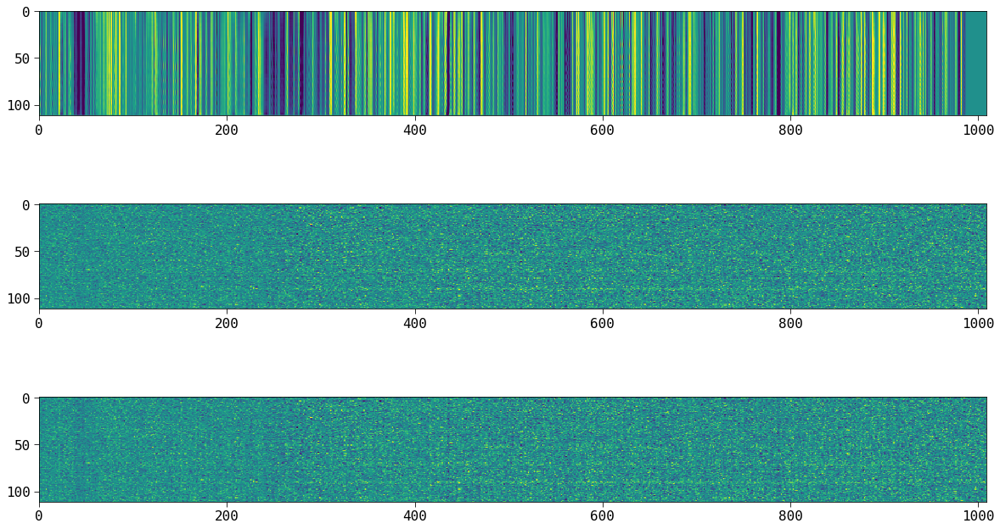

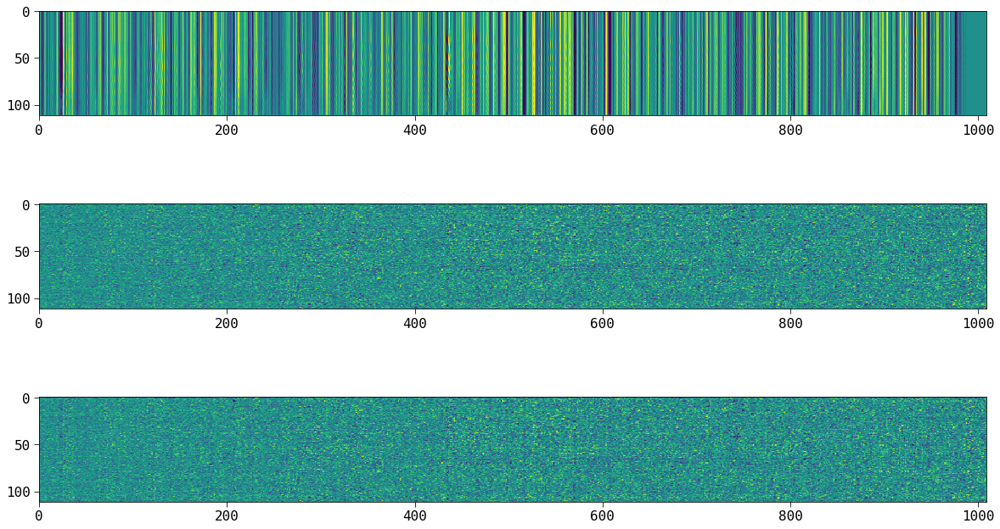

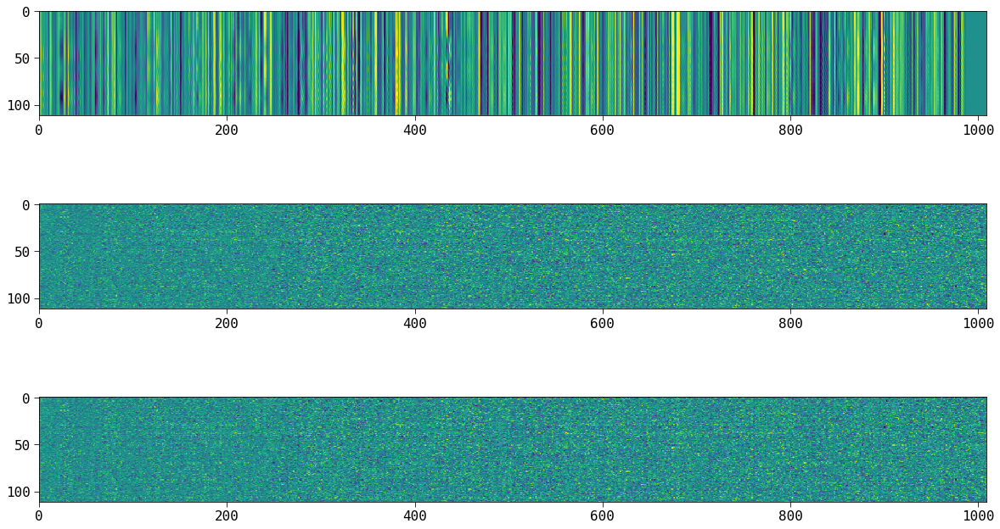

...

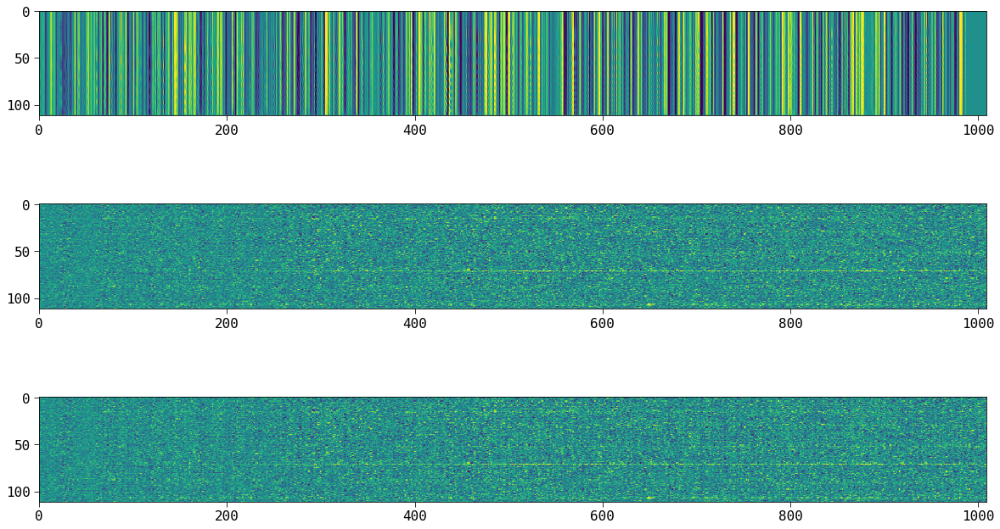

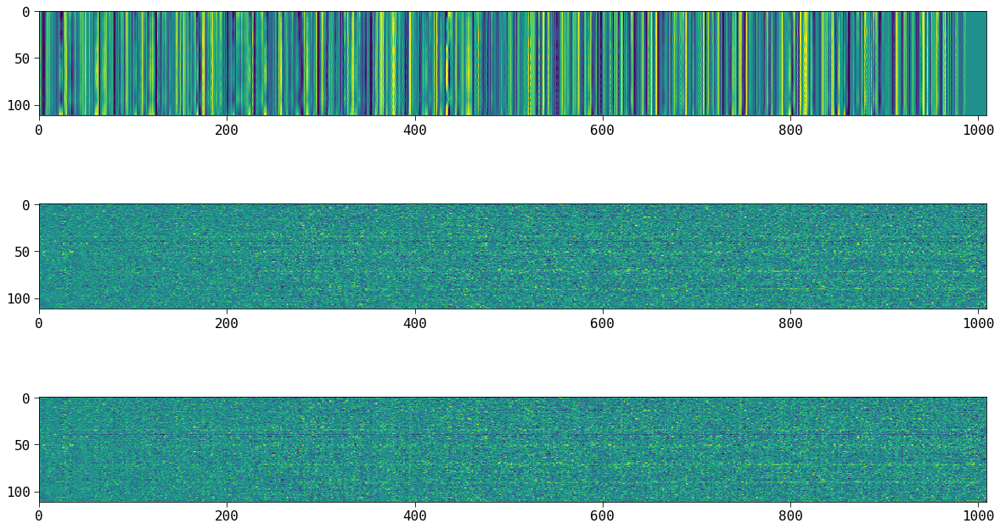

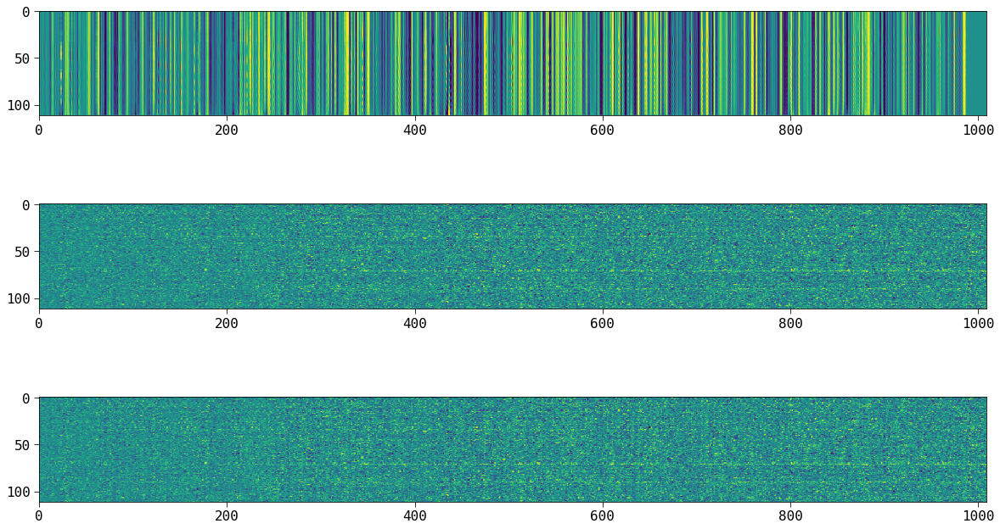

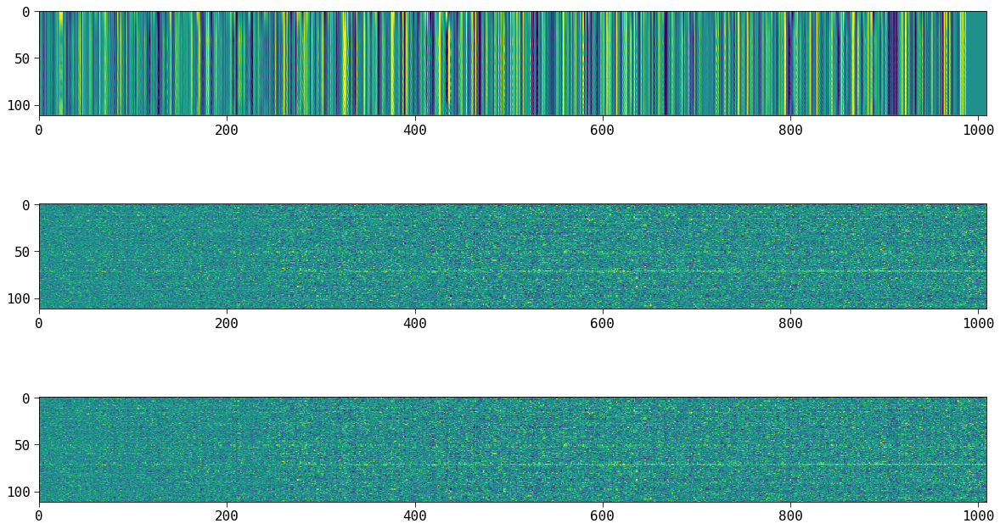

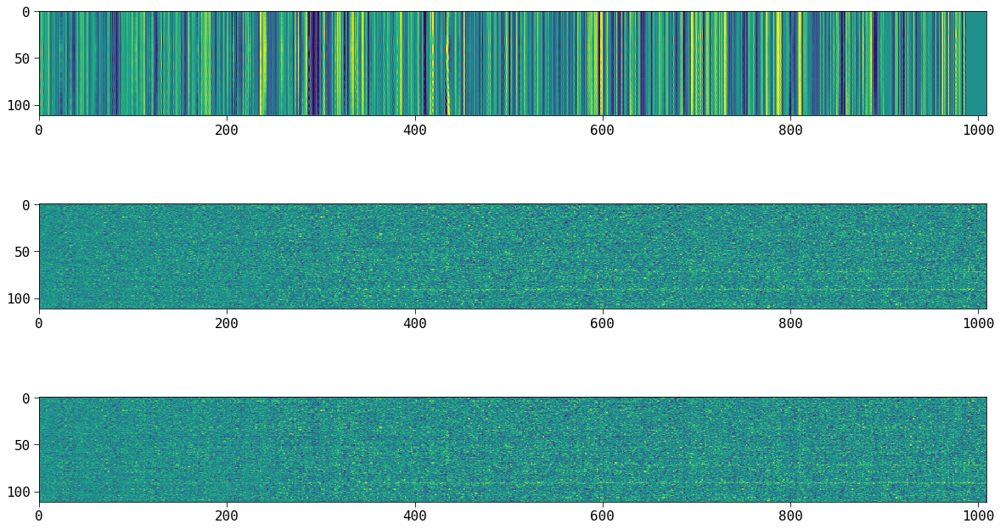

In [76]:
for k in  shotids:
    for amp in ["LU", "LL", "RU", "RL"]:
        shotid, exp = k
        pattern = "pca_test/rebin/{}/{}/pca_multi_???_{}_???_{}_rebin.pickle".format(shotid, exp, IFU, amp)
        ff = glob.glob(pattern)
        print(pattern)
        ww,rb = pickle.load(open(ff[0], 'rb'))

        f = plt.figure(figsize=[20,20])
        #plt.subplot(511)
        #plt.imshow( rb['sky_spectrum'] , vmax=200.)
        #plt.subplot(512)
        #plt.imshow( rb['pca_sky_spectrum'] , vmax=200.)
        plt.subplot(513)
        plt.imshow( rb['sky_spectrum'] - rb['pca_sky_spectrum'], vmin=-2., vmax=2. )
        
        plt.subplot(514)
        plt.imshow( rb['sky_subtracted'], vmin=-50., vmax=50. ) 
        plt.subplot(515)
        plt.imshow( rb['sky_subtracted'] + rb['sky_spectrum'] - rb['pca_sky_spectrum'] , vmin=-50., vmax=50. )
        break
    

In [ ]:
fn = "pca_test/rebin/20180110v021/exp01/pca_multi_317_022_039_LU_rebin.pickle"
ff = glob.glob(fn.format(IFU))
fn = ff[0]
print(fn)
ww,rb = pickle.load(open(fn, 'rb'))


f = plt.figure(figsize=[15,5])
#f = plt.figure()
plt.subplot(311)
plt.imshow( rb['sky_spectrum'] , vmax=300.)
plt.subplot(312)
plt.imshow( rb['pca_sky_spectrum'] , vmax=300.)
plt.subplot(313)
plt.imshow( rb['sky_spectrum'] - rb['pca_sky_spectrum'], vmin=-2., vmax=2. )

In [47]:
from scipy.ndimage.filters import gaussian_filter

pca_test/rebin/20180110v021/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180110v021/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180110v021/exp03/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180113v013/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180113v013/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180113v013/exp03/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180114v013/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180114v013/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180114v013/exp03/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180120v008/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180120v008/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180120v008/exp03/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180123v009/exp01/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180123v009/exp02/pca_multi_???_022_???_LU_rebin

/Users/mxhf/.pyenv/versions/anaconda3-4.3.1/lib/python3.5/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


pca_test/rebin/20180210v006/exp02/pca_multi_???_022_???_LU_rebin.pickle
pca_test/rebin/20180210v006/exp03/pca_multi_???_022_???_LU_rebin.pickle


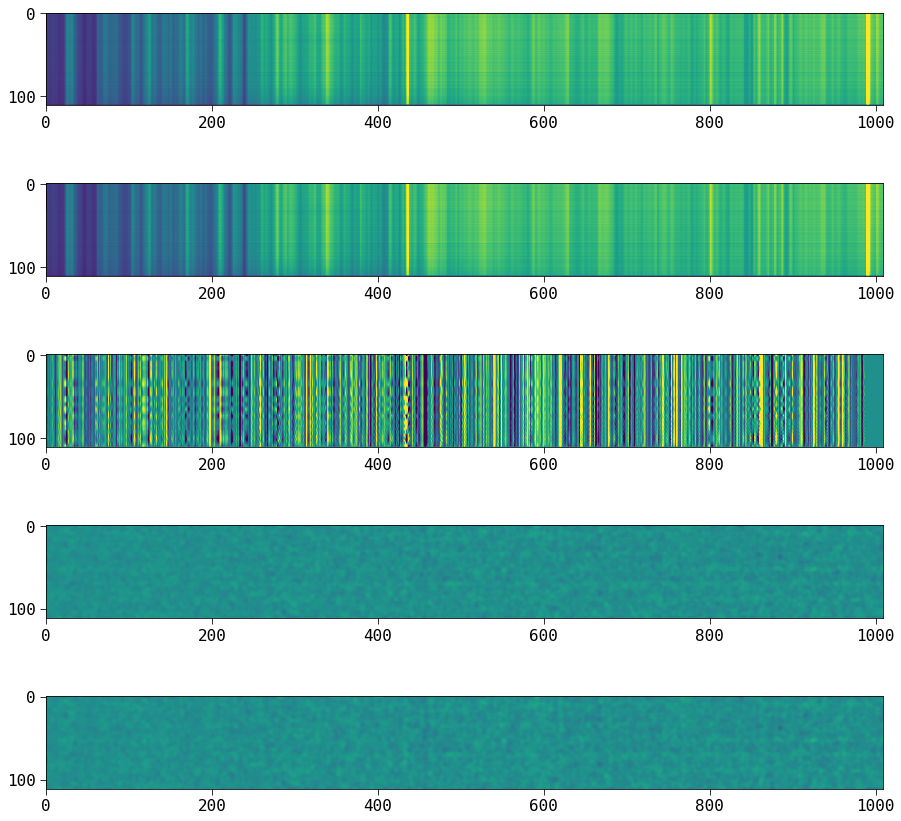

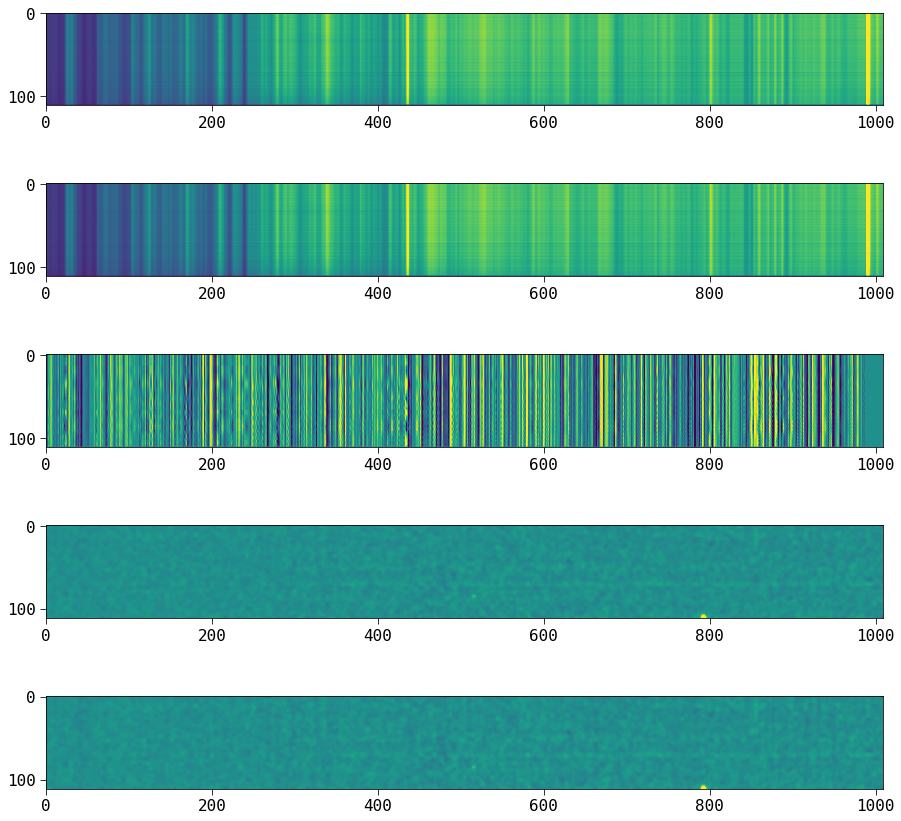

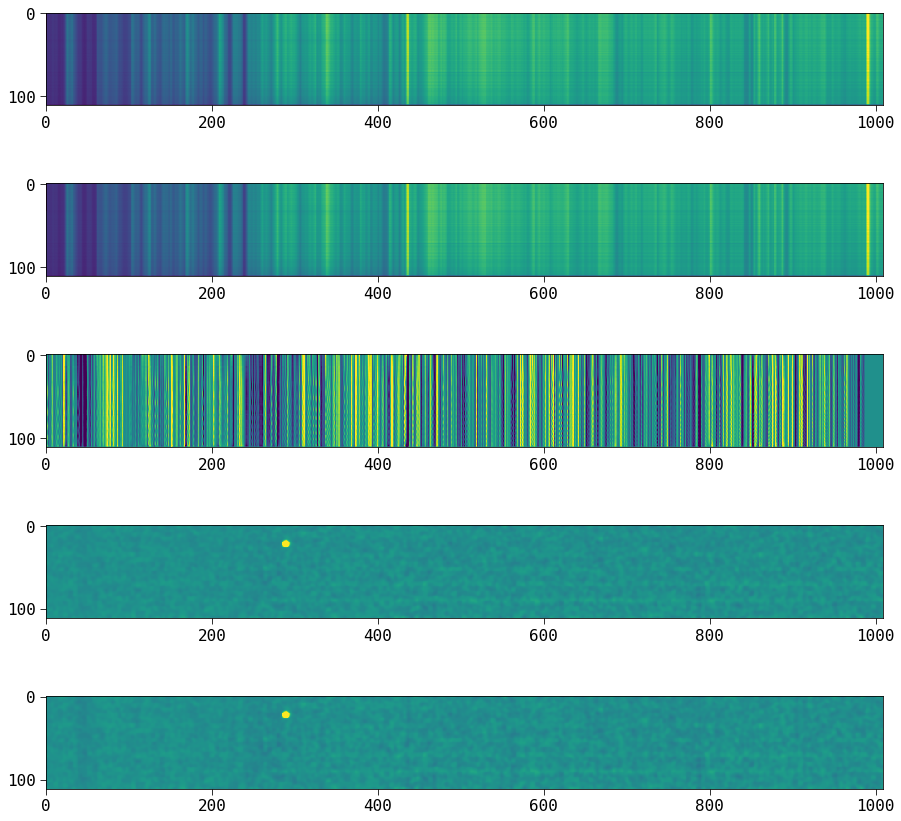

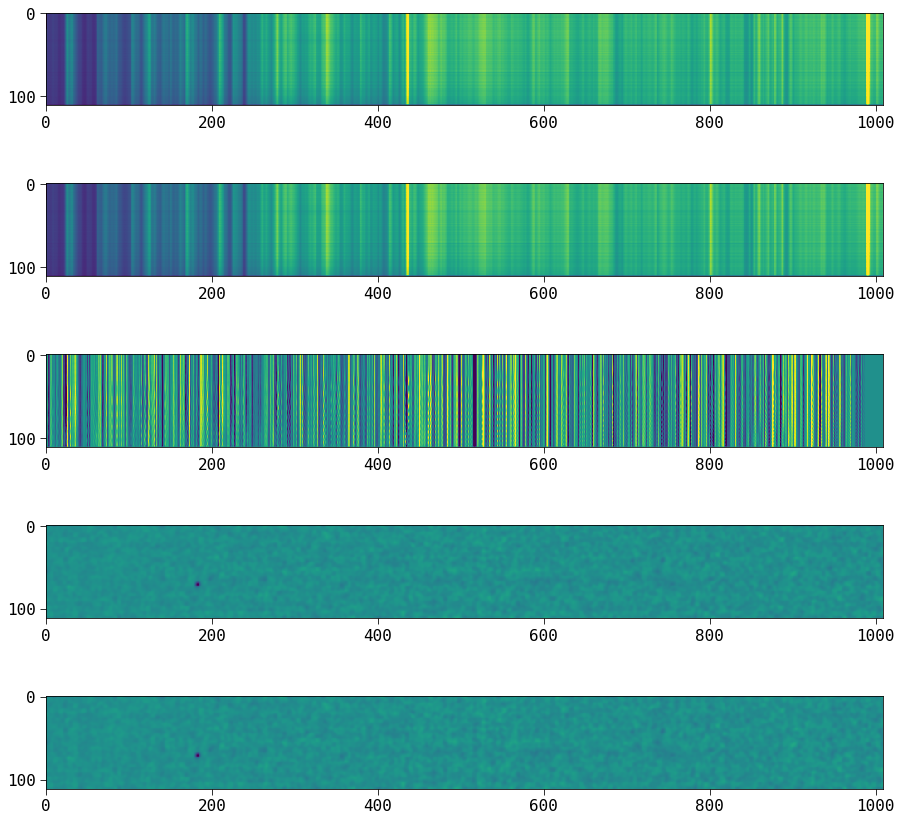

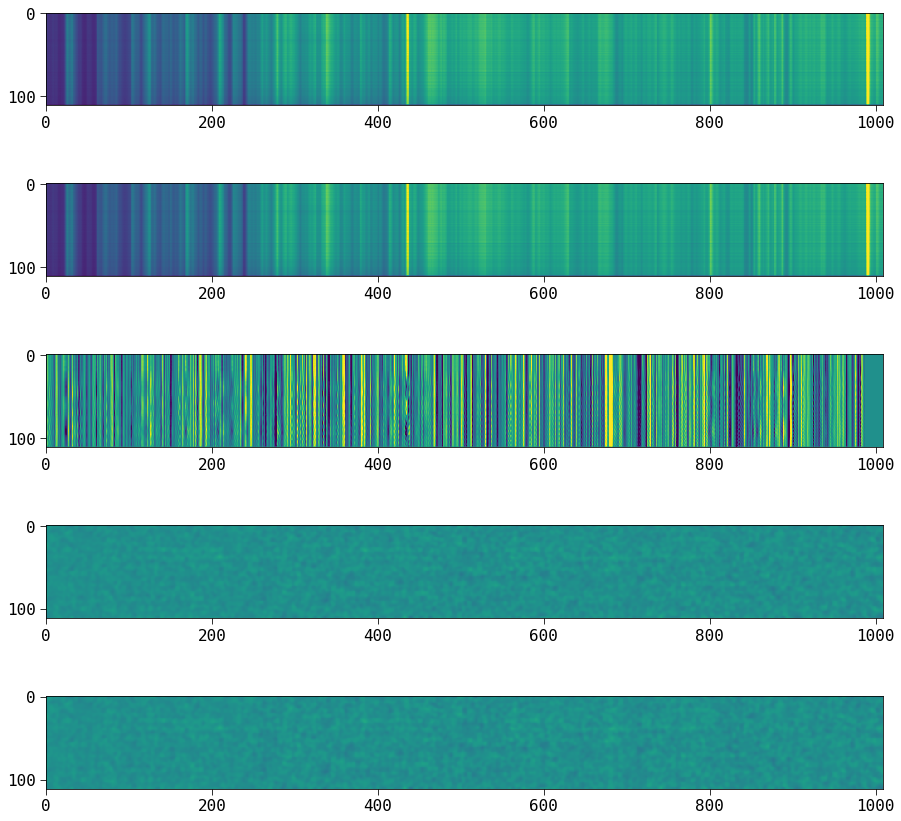

...

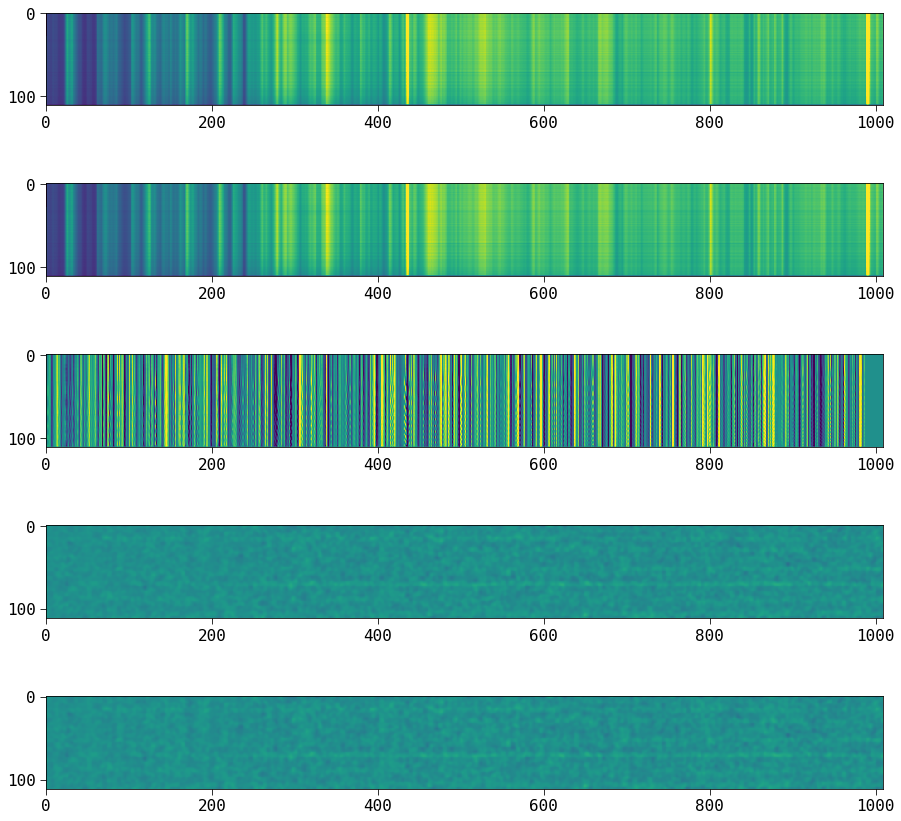

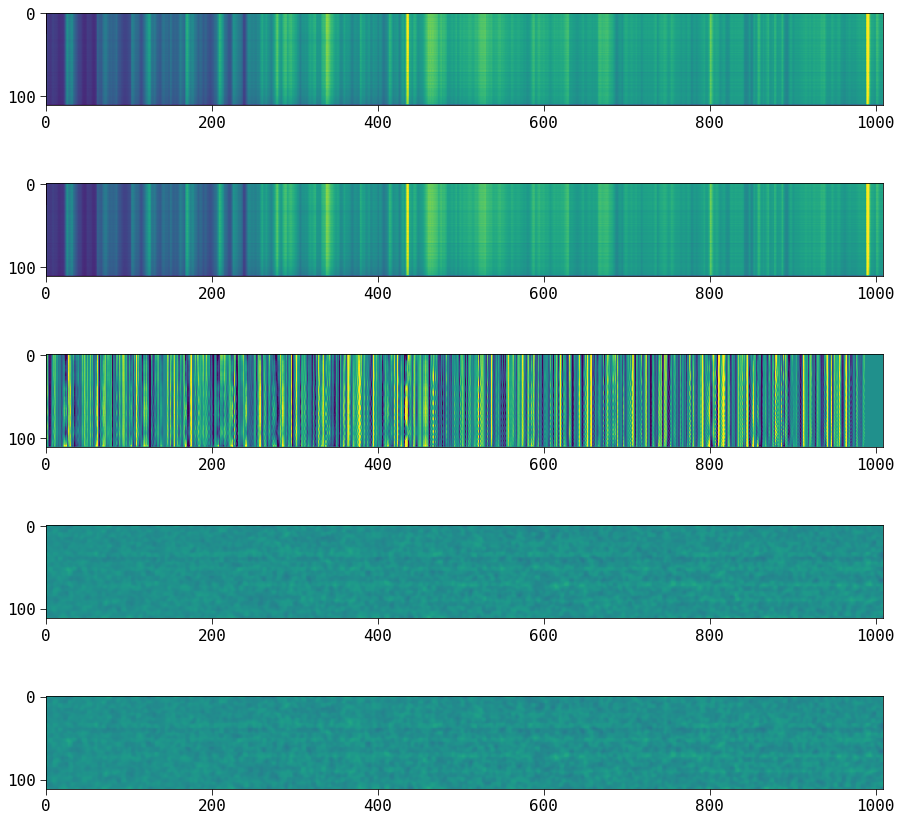

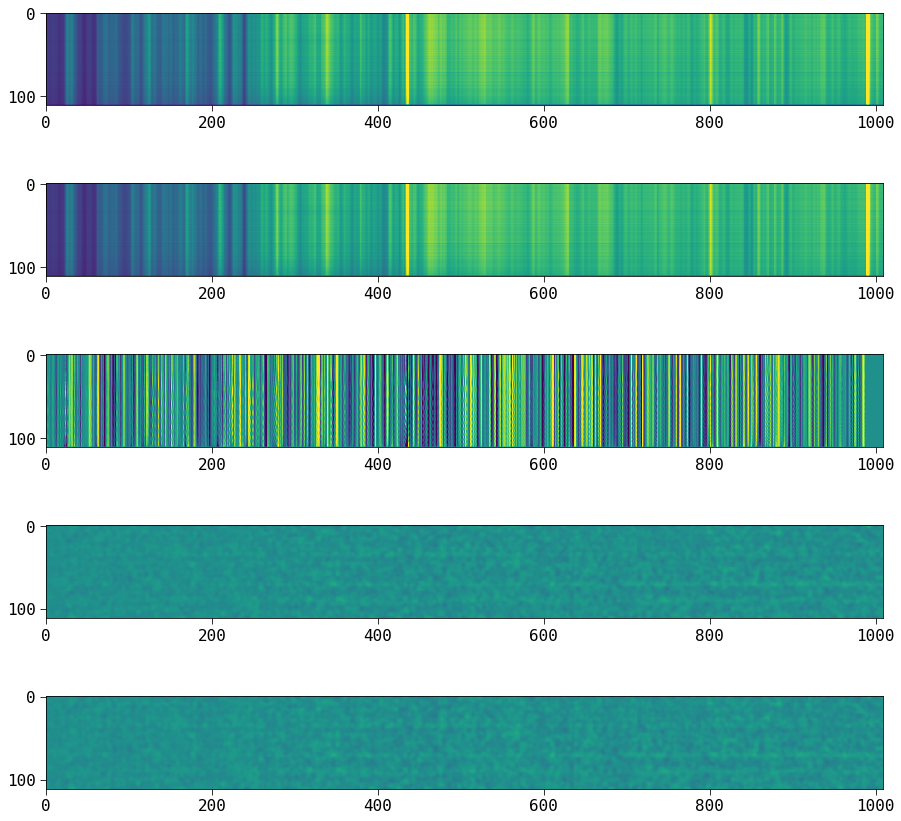

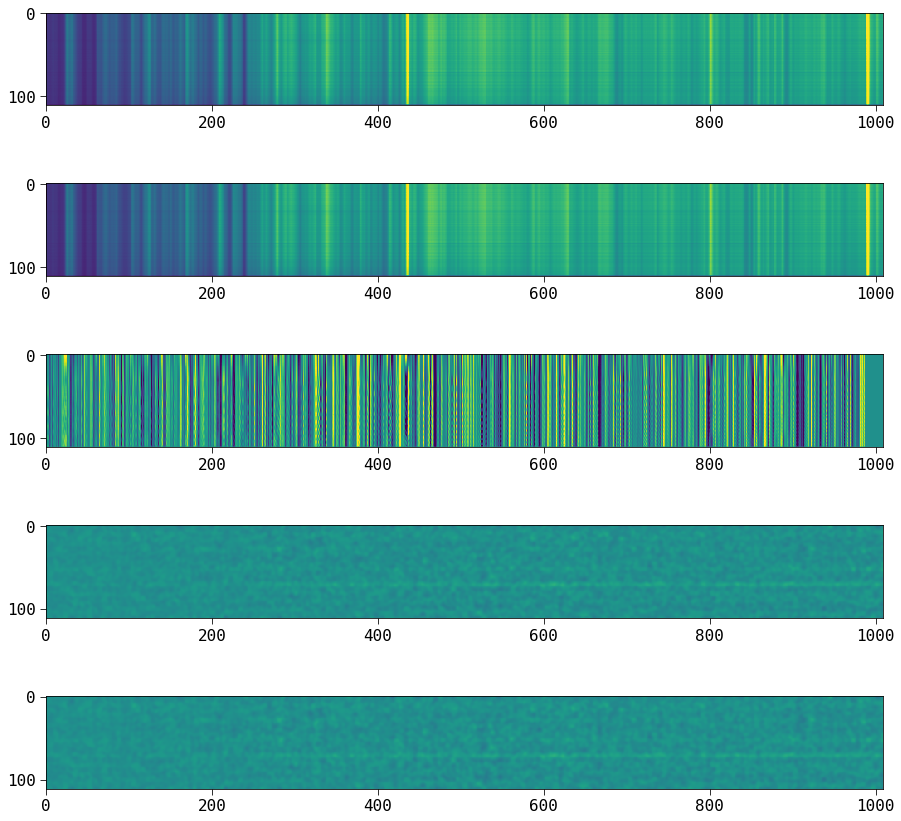

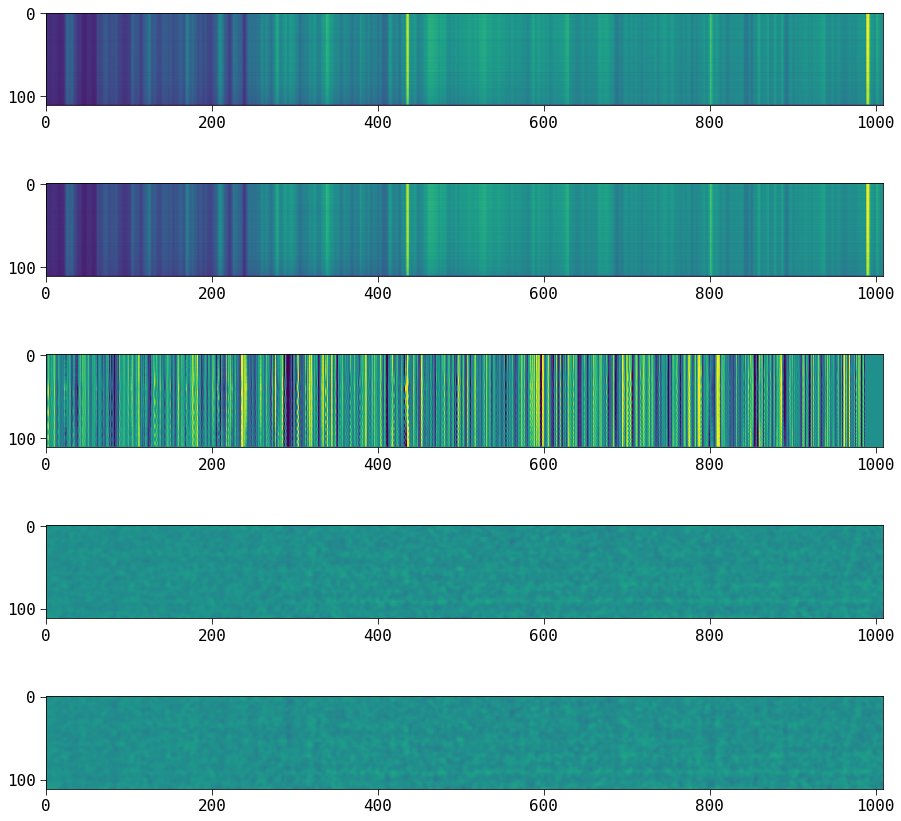

In [77]:
#pca_test/rebin/20180110v021/exp01/pca_multi_317_022_039_LU_rebin.pickle


for k in shotids:
    for amp in ["LU", "LL", "RU", "RL"]:
        shotid, exp = k
        pattern = "pca_test/rebin/{}/{}/pca_multi_???_{}_???_{}_rebin.pickle".format(shotid, exp, IFU, amp)
        ff = glob.glob(pattern)
        print(pattern)
        ww,rb = pickle.load(open(ff[0], 'rb'))

        f = plt.figure(figsize=[15,15])
        plt.subplot(511)
        plt.imshow( rb['sky_spectrum'] , vmin=0., vmax=300.)
        plt.subplot(512)
        plt.imshow( rb['pca_sky_spectrum'] , vmin=0., vmax=300.)
        plt.subplot(513)
        plt.imshow( rb['sky_spectrum'] - rb['pca_sky_spectrum'], vmin=-2., vmax=2. )
        
        plt.subplot(514)
        im = rb['sky_subtracted']
        plt.imshow( gaussian_filter(im,2.)  , vmin=-50., vmax=50. ) 
        plt.subplot(515)
        
        im = rb['sky_subtracted'] + rb['sky_spectrum'] - rb['pca_sky_spectrum'] 
        
        plt.imshow( gaussian_filter(im,2.) , vmin=-50., vmax=50. )
        break

In [ ]:
from scipy.ndimage.filters import gaussian_filter

In [ ]:
gaussian_filter?